In [3]:
from IPython.display import clear_output 

每位選手起始為 501 分，

選手積分隨投擲得分而遞減

首先將分減為0的選手獲勝

如果選手投中某鏢後使積分減成無法結束遊戲的分數(正常出積分＜0；雙倍區積分≤1；三倍區積分≤2或者在雙倍區/三倍區出條件下，投中非雙倍區/三倍區使積分減為0)為"爆鏢"，發生爆鏢後，取消該輪得分，同時結束本輪投擲，輪到下位選手投鏢。



<!-- ![image.png](attachment:image.png) -->

In [4]:
from IPython.display import Image
Image(url= "https://img.my-best.tw/press_component/item_part_images/a1a4524fc6e0cb33af25f53c65897062.jpg?ixlib=rails-4.2.0&q=70&lossless=0&w=640&h=640&fit=clip", width=300, height=00)

# Probability

面積 398.5 pi

圓心： 2.5 pi

一倍區內圈每個數字： 5.85 pi (20區)

三倍區每個數字： 1.7625 pi (20區)

一倍區外區每個數字: 9.3 pi (20區)

兩倍區每個數字： 2.8875 pi (20區)


In [5]:
import numpy as np

## 固定的機率

In [6]:
#以單一 action 來說的機率
#鄰居區域
neighbor_table={1:[18,20],2:[15,17],3:[17,19],4:[13,18],5:[12,20],6:[10,13],7:[16,19],8:[11,16],
                 9:[12,14],10:[6,15],11:[8,14],12:[5,9],13:[4,6],14:[9,11],15:[2,10],
                 16:[7,8],17:[2,3],18:[1,4],19:[3,7],20:[1,5],50:[x+1 for x in range(20)]}

#不同類型區塊面積
area_table={'bull':3,'3x':1.7625,'1x_in':5.85,'2x':2.8875,'1x_out':9.3}
#擊中鄰區機率
# single_zone_cdf={'3x':1.7625/19.8,'2x':2.8875/19.8+1.7625/19.8,'1x':1}
x1_out_neighbor_cdf=[0.28571429, 0.57142857, 0.66013825, 0.74884793, 0.8375576 ,0.89170507, 0.94585253, 1.] #1xleft,1xright,2xleft,2x,2xright,3xleft,3x,3xright
x2_neighbor_cdf=[0.19331849, 0.38663698, 0.57995547, 0.63997774, 0.70000001] #1x,1xleft,1xright,2xleft,2xright
x1_in_neighbor_cdf=[0.29268293, 0.58536585, 0.67354597, 0.76172608, 0.84990619,1.] #1xleft,1xright,3xleft,3x,3xright,bull
x3_neighbor_cdf=[0.3093415 , 0.618683  , 0.9280245 , 0.96401225, 1.] #1x,1xleft,1xright,3xleft,3xright
neighbor_cdf=[x1_in_neighbor_cdf,x3_neighbor_cdf,x1_out_neighbor_cdf,x2_neighbor_cdf]

## 不同技術等級

In [7]:
def setPlayer_ability(level):
    #正中該區、擊中鄰區、未擊中機率
    if level == 0:
        acc = [1,1,1,1,1]
    if level == 1:
        acc = [1.05,1.05,1.05,1.05,1.05]
    if level == 2:
        acc = [1.1,1.05,1.1,1.1,1.1]
    
    x2_action_cdf={'hit_area':0.28875*acc[0],'hit_neighbor':0.99,'miss':1}
    x1_out_action_cdf={'hit_area':0.93*acc[1],'hit_neighbor':0.99,'miss':1}
    x3_action_cdf={'hit_area':0.17625*acc[2],'hit_neighbor':0.99,'miss':1}
    x1_in_action_cdf={'hit_area':0.585*acc[3],'hit_neighbor':0.99,'miss':1}
    bull_action_cdf={'hit_area':0.3*acc[4],'hit_neighbor':0.99,'miss':1}
    zone_action_cdf=[x1_in_action_cdf,x3_action_cdf,x1_out_action_cdf,x2_action_cdf]
    return x2_action_cdf, x1_out_action_cdf,x3_action_cdf,x1_in_action_cdf,bull_action_cdf,zone_action_cdf

In [8]:
x2_action_cdf, x1_out_action_cdf,x3_action_cdf,x1_in_action_cdf,bull_action_cdf,zone_action_cdf = setPlayer_ability(0)

# Game

Rule:
1. 除 End Game state 外可以選擇 81種動作: 射擊圓心、20個區域的[1倍內圈、3倍區、1倍外圈、2倍區]
2. 不會選擇擊中後會超過分數的動作(eg.剩餘10分，不會射擊20分一倍區)，但有可能會發生
3. 根據所選動作不同，擊中的機率不同、擊中鄰近區域的可能性不同，另外還有失誤機率
4. 每一回合可以射 3 鏢，假如射出超於現在分數的情況，立刻結束這回合
5. 在回合中任一次射擊機會，將分數歸零，立即結束遊戲
6. 在最少回合內獲勝最佳

In [9]:
import numpy as np

In [10]:
def shoot(action) -> int:
    zone_type=['1x_in','3x','1x_out','2x']
    zone_ratio=[1,3,1,2]
    # calculate probabilities
    hit_miss,neighbor_prob=np.random.rand(2)
    
    if action[0] == 'bull':
        if hit_miss <= bull_action_cdf['hit_area']:
            print('hit Bull!')
            return 50
        elif hit_miss <= bull_action_cdf['hit_neighbor']:
            hit_zone = int(neighbor_prob/0.05)+1
            print('hit neighbor: [{}] 1x zone!'.format(hit_zone))
            return hit_zone
        else:
            print('Miss!')
            return 0
    else: # 1-20 area
        if hit_miss <= zone_action_cdf[action[1]]['hit_area']:
            print('hit [{}] {} zone'.format(action[0],zone_type[action[1]]))
            return action[0]*zone_ratio[action[1]]
            
        elif hit_miss<=zone_action_cdf[action[1]]['hit_neighbor']:
            neighbor_prob_list=neighbor_cdf[action[1]]
            if action[1]==0: #1x_in 
            #1xleft,1xright,3xleft,3x,3xright,bull
                if neighbor_prob <= neighbor_prob_list[0]:
                    reward = neighbor_table[action[0]][0]
                elif neighbor_prob <= neighbor_prob_list[1]:
                    reward = neighbor_table[action[0]][1]
                elif neighbor_prob <= neighbor_prob_list[2]:
                    reward = neighbor_table[action[0]][0]*3
                elif neighbor_prob <= neighbor_prob_list[3]:
                    reward = action[0]*3
                elif neighbor_prob <= neighbor_prob_list[4]:
                    reward = neighbor_table[action[0]][1]*3
                elif neighbor_prob <= neighbor_prob_list[5]:
                    reward = 50
                else:
                    print(neighbor_prob_list)
                    print(neighbor_prob)
                    assert False,'1-error'
                print(f"hit [{reward}] X 1_In zone")
                return reward
            
            elif action[1]==1: #3x
            #1x,1xleft,1xright,3xleft,3xright
                if neighbor_prob <= neighbor_prob_list[0]:
                    reward = action[0]
                elif neighbor_prob <= neighbor_prob_list[1]:
                    reward = neighbor_table[action[0]][0]
                elif neighbor_prob <= neighbor_prob_list[2]:
                    reward = neighbor_table[action[0]][1]
                elif neighbor_prob <= neighbor_prob_list[3]:
                    reward = neighbor_table[action[0]][0]*3
                elif neighbor_prob <= neighbor_prob_list[4]:
                    reward = neighbor_table[action[0]][1]*3
                else:
                    print(neighbor_prob_list)
                    print(neighbor_prob)
                    assert False,'2-error'
                print(f"hit [{reward}] X 3 zone")
                return reward
            
            elif action[1]==2: #1x_out
            #1xleft,1xright,2xleft,2x,2xright,3xleft,3x,3xright
                if neighbor_prob <= neighbor_prob_list[0]:
                    reward = neighbor_table[action[0]][0]
                elif neighbor_prob <= neighbor_prob_list[1]:
                    reward = neighbor_table[action[0]][1]
                elif neighbor_prob <= neighbor_prob_list[2]:
                    reward = neighbor_table[action[0]][0]*2
                elif neighbor_prob <= neighbor_prob_list[3]:
                    reward = action[0]*2
                elif neighbor_prob <= neighbor_prob_list[4]:
                    reward = neighbor_table[action[0]][1]*2
                elif neighbor_prob <= neighbor_prob_list[5]:
                    reward = neighbor_table[action[0]][0]*3
                elif neighbor_prob <= neighbor_prob_list[6]:
                    reward = action[0]*3
                elif neighbor_prob <= neighbor_prob_list[7]:
                    reward = neighbor_table[action[0]][1]*3  
                else:
                    print(neighbor_prob_list)
                    print(neighbor_prob)
                    assert False,'3-error'
                print(f"hit [{reward}] X 1_out zone")
                return reward    
            
            
            elif action[1]==3: #2x
            #1x,1xleft,1xright,2xleft,2xright
                if neighbor_prob<=neighbor_prob_list[0]:
                    reward=action[0]
                elif neighbor_prob<=neighbor_prob_list[1]:
                    reward=neighbor_table[action[0]][0]
                elif neighbor_prob<=neighbor_prob_list[2]:
                    reward=neighbor_table[action[0]][1]
                elif neighbor_prob<=neighbor_prob_list[3]:
                    reward=neighbor_table[action[0]][0]*2
                elif neighbor_prob<=neighbor_prob_list[4]:
                    reward=neighbor_table[action[0]][1]*2
                else:
                    print('Miss!Shoot Outside!')
                    return 0
                print(f"hit [{reward}] X 2 zone")
                return reward
            
            else:
                assert False,'error'
            print('hit neighbor for [{}] pts.'.format(reward))  
        else:
            print('Miss!')
            return 0

In [11]:
def isBust(current_point, minus_point)-> bool:
    return (minus_point > current_point)

In [12]:
def isGameOver(current_point, minus_point)-> bool:
    return not (current_point-minus_point)

In [13]:
def ramdom_action(points):
    zone_ratio=[1,3,1,2]
    points_table=[(int(i//4)+1)*zone_ratio[i%4] for i in range(80)]
    points_table.append(50)
    # 人並不會故意把自己搞 Bust
    available_idx = [i for i in range(81) if points_table[i] <= points]
    # 隨機挑一個射
    act_idx = np.random.randint(0,len(available_idx))
    assert points >= points_table[available_idx[act_idx]],'points :{}, choose action points:{}'.format(points,points_table[available_idx[act_idx]])
    return available_idx[act_idx]

In [14]:
def play_game(police=0,show=True)->int:
    
    current_points = 501
    turns = 0
    zone_type=['1x_in','3x','1x_out','2x']
    game = True
    act_stamp = []
    score_stamp = []
    
    while game:
        turns += 1
        if show:
            print('================Round {}================'.format(turns))
            print('[Current Points: {} points]'.format(current_points))
        
        for i in range(3):
            if police == 0:
                act = ramdom_action(current_points)
            if police == 1:
                act = greedy_action(current_points,turns*3)
            
            act_stamp.append(act)
            score_stamp.append(current_points)
            
            if act == 80:
                act = ['bull']
            else:
                act = [int(act//4)+1,act%4]
            if len(act)==1:
                if show:
                    print('--Action: {}'.format(act))
            else:
                if show:
                    print('--Action: {} for {} zone'.format(act[0],zone_type[act[1]]))
                
            minus_point = shoot(act)
            
            if isBust(current_points,minus_point):
                break
                      
            if isGameOver(current_points,minus_point):
                print('===========You Win the Game by {} Rounds==========='.format(turns))
                game = False
                break
            
            current_points -= minus_point
            
    return turns,score_stamp,act_stamp

## Try Play with Ramdom Level - 1

In [15]:
games = 300
_round = [play_game()[0] for i in range(games)]

================Round 1================
[Current Points: 501 points]
--Action: 9 for 1x_out zone
hit [9] 1x_out zone
--Action: 11 for 1x_out zone
hit [11] 1x_out zone
--Action: 12 for 1x_out zone
hit [12] 1x_out zone
================Round 2================
[Current Points: 469 points]
--Action: 2 for 1x_in zone
hit [2] 1x_in zone
--Action: 4 for 2x zone
hit [13] X 2 zone
--Action: 19 for 2x zone
hit [19] 2x zone
================Round 3================
[Current Points: 416 points]
--Action: 5 for 1x_in zone
hit [5] 1x_in zone
--Action: 2 for 1x_out zone
hit [2] 1x_out zone
--Action: 17 for 1x_in zone
hit [3] X 1_In zone
================Round 4================
[Current Points: 406 points]
--Action: 11 for 3x zone
hit [11] X 3 zone
--Action: 9 for 1x_out zone
hit [9] 1x_out zone
--Action: 17 for 1x_in zone
hit [50] X 1_In zone
================Round 5================
[Current Points: 336 points]
--Action: 17 for 1x_in zone
hit [17] 1x_in zone
--Action: 3 for 2x zone
hit [3] 2x zone
--Actio

In [16]:
print(f'Average rounds {np.mean(_round)} for {games} try')
print(f'Average shoot {np.mean(_round)*3} for {games} try')

Average rounds 14.406666666666666 for 300 try
Average shoot 43.22 for 300 try


## Try Play with Ramdom Level - 2

In [17]:
x2_action_cdf, x1_out_action_cdf,x3_action_cdf,x1_in_action_cdf,bull_action_cdf,zone_action_cdf = setPlayer_ability(1)
games = 300
_round = [play_game()[0] for i in range(games)]

================Round 1================
[Current Points: 501 points]
--Action: 9 for 2x zone
Miss!
--Action: 15 for 2x zone
hit [15] X 2 zone
--Action: 13 for 2x zone
hit [13] 2x zone
================Round 2================
[Current Points: 460 points]
--Action: 4 for 3x zone
hit [4] 3x zone
--Action: 4 for 1x_in zone
hit [4] 1x_in zone
--Action: 8 for 3x zone
hit [8] 3x zone
================Round 3================
[Current Points: 420 points]
--Action: 13 for 2x zone
hit [4] X 2 zone
--Action: 19 for 2x zone
hit [19] 2x zone
--Action: 16 for 3x zone
hit [16] X 3 zone
================Round 4================
[Current Points: 362 points]
--Action: 6 for 2x zone
Miss!Shoot Outside!
--Action: 10 for 1x_out zone
hit [6] X 1_out zone
--Action: 14 for 3x zone
hit [11] X 3 zone
================Round 5================
[Current Points: 345 points]
--Action: 19 for 1x_out zone
hit [19] 1x_out zone
--Action: 10 for 2x zone
Miss!Shoot Outside!
--Action: 6 for 1x_in zone
hit [6] 1x_in zone
=========

In [18]:
print(f'Average rounds {np.mean(_round)} for {games} try')
print(f'Average shoot {np.mean(_round)*3} for {games} try')

Average rounds 14.526666666666667 for 300 try
Average shoot 43.58 for 300 try


## Try Play with Ramdom Level - 3

In [19]:
x2_action_cdf, x1_out_action_cdf,x3_action_cdf,x1_in_action_cdf,bull_action_cdf,zone_action_cdf = setPlayer_ability(2)
games = 300
_round = [play_game()[0] for i in range(games)]

================Round 1================
[Current Points: 501 points]
--Action: 19 for 3x zone
hit [3] X 3 zone
--Action: 17 for 3x zone
hit [3] X 3 zone
--Action: 8 for 3x zone
hit [8] 3x zone
================Round 2================
[Current Points: 471 points]
--Action: 6 for 3x zone
hit [6] 3x zone
--Action: 15 for 1x_out zone
hit [15] 1x_out zone
--Action: 19 for 3x zone
hit [21] X 3 zone
================Round 3================
[Current Points: 417 points]
--Action: 3 for 2x zone
hit [3] 2x zone
--Action: 1 for 3x zone
hit [1] 3x zone
--Action: 19 for 3x zone
hit [3] X 3 zone
================Round 4================
[Current Points: 405 points]
--Action: 7 for 2x zone
Miss!Shoot Outside!
--Action: 15 for 2x zone
Miss!Shoot Outside!
--Action: 19 for 2x zone
hit [19] X 2 zone
================Round 5================
[Current Points: 386 points]
--Action: 18 for 3x zone
hit [18] X 3 zone
--Action: 9 for 3x zone
hit [12] X 3 zone
--Action: 6 for 2x zone
hit [20] X 2 zone
================R

In [20]:
print(f'Average rounds {np.mean(_round)} for {games} try')
print(f'Average shoot {np.mean(_round)*3} for {games} try')

Average rounds 14.063333333333333 for 300 try
Average shoot 42.19 for 300 try


## Markov Decision Process

In [28]:
def get_avalibe_move(state):
    # 人並不會故意把自己搞 Bust
    zone_ratio=[1,3,1,2]
    points_table=[(int(i//4)+1)*zone_ratio[i%4] for i in range(80)]
    points_table.append(50)
    return [i for i in range(81) if points_table[i] <= state]

In [29]:
def get_except_state(act):
    if act == 80:
        return 50
    elif act%4==0:return (act//4+1)
    elif act%4==1:return (act//4+1)*3
    elif act%4==2:return (act//4+1)
    elif act%4==3:return (act//4+1)*2

In [30]:
get_except_state(77)

60

In [31]:
def get_action_reward(k,points):#r(s,a)
    """
    Input:
        act = (81種行為的其中一種)  
    Return:
        action_value = (擊中分數 * 擊中機率 + 誤射分數 * 誤射機率)   
    """ 
    
    zone_x = [1,3,1,2]
    reward=0
    if k==80:  #shoot bool
        #shoot
        if 50 > points:
            reward+=bull_action_cdf['hit_area']*PUNISH
        else:
            reward+=bull_action_cdf['hit_area']*50
        #shoot neighbor
        for i in range(1,21):
            if i>points:
                reward+=( (bull_action_cdf['hit_neighbor']/20 - bull_action_cdf['hit_area']/20 ))*PUNISH
            else:
                reward+=( (bull_action_cdf['hit_neighbor']/20 - bull_action_cdf['hit_area']/20 ) )*i #average 20 zone
        #miss
        reward+=0
    elif k%4==0: #shoot 1x_in
        #shoot
        if (k//4+1) > points:
            reward+=x1_in_action_cdf['hit_area']*PUNISH
        else:
            reward+=x1_in_action_cdf['hit_area']*(k//4+1)
        #shoot neighbor 
        neighbor_prob=neighbor_cdf[0].copy()
        neighbor_prob.insert(0,0)
        probs=[neighbor_prob[i]-neighbor_prob[i-1] for i in range(1,len(neighbor_prob))]
        probs=[x*(x1_in_action_cdf['hit_neighbor']-x1_in_action_cdf['hit_area']) for x in probs]
        leftx=neighbor_table[k//4+1][0]
        rightx=neighbor_table[k//4+1][1]
        #1xleft,1xright,3xleft,3x,3xright,bull
        r=[leftx,rightx,leftx*3,(k//4+1)*3,rightx*3,50]
        for i in range(len(r)):
            if r[i]>points:
                r[i]=PUNISH
            reward+=(r[i]*probs[i])
        #miss
        reward+=0
    elif k%4==1: #shoot 3x
        #shoot
        if (k//4+1)*3 > points:
            reward+=x3_action_cdf['hit_area']*PUNISH
        else:
            reward+=x3_action_cdf['hit_area']*(k//4+1)*3
        #shoot neighbor 
        neighbor_prob=neighbor_cdf[1].copy()
        neighbor_prob.insert(0,0)
        probs=[neighbor_prob[i]-neighbor_prob[i-1] for i in range(1,len(neighbor_prob))]
        probs=[x*(x3_action_cdf['hit_neighbor']-x3_action_cdf['hit_area']) for x in probs]
        leftx=neighbor_table[k//4+1][0]
        rightx=neighbor_table[k//4+1][1]
        #1x,1xleft,1xright,3xleft,3xright
        r=[(k//4)+1,leftx,rightx,leftx*3,rightx*3]
        for i in range(len(r)):
            if r[i]>points:
                r[i]=PUNISH
            reward+=(r[i]*probs[i])
#         reward+=(probs[0]*(k//4+1)+probs[1]*leftx+probs[2]*rightx+probs[3]*leftx*3+probs[4]*rightx*3)
        #miss
        reward+=0
    elif k%4==2: #shoot 1x_out
        #shoot
        if (k//4+1) > points:
            reward+=x1_out_action_cdf['hit_area']*PUNISH
        else:
            reward+=x1_out_action_cdf['hit_area']*(k//4+1)
        #shoot neighbor 
        neighbor_prob=neighbor_cdf[2].copy()
        neighbor_prob.insert(0,0)
        probs=[neighbor_prob[i]-neighbor_prob[i-1] for i in range(1,len(neighbor_prob))]
        probs=[x*(x1_out_action_cdf['hit_neighbor']-x1_out_action_cdf['hit_area']) for x in probs]
        leftx=neighbor_table[k//4+1][0]
        rightx=neighbor_table[k//4+1][1]
        #1xleft,1xright,2xleft,2x,2xright,3xleft,3x,3xright
        r=[leftx,rightx,leftx*2,(k//4+1)*2,rightx*2,leftx*3,rightx*3]
        for i in range(len(r)):
            if r[i]>points:
                r[i]=PUNISH
            reward+=(r[i]*probs[i])
#         reward+=(probs[0]*leftx+probs[1]*rightx+probs[2]*leftx*2+probs[3]*(k//4+1)*2+probs[4]*rightx*2+\
#                  probs[5]*leftx*3+probs[6]*(k//4+1)*3+probs[7]*rightx*3)
        #miss
        reward+=0
    elif k%4==3: #shoot 2x
        #shoot
        if (k//4+1)*2 > points:
            reward += x2_action_cdf['hit_area']*PUNISH
        else:
            reward += x2_action_cdf['hit_area']*(k//4+1)*2
        #shoot neighbor 
        neighbor_prob=neighbor_cdf[3].copy()
        neighbor_prob.insert(0,0)
        probs=[neighbor_prob[i]-neighbor_prob[i-1] for i in range(1,len(neighbor_prob))]
        probs=[x*(x2_action_cdf['hit_neighbor']-x2_action_cdf['hit_area']) for x in probs]
        leftx=neighbor_table[k//4+1][0]
        rightx=neighbor_table[k//4+1][1]
        #1x,1xleft,1xright,2xleft,2xright
        r=[(k//4+1),leftx,rightx,leftx*2,rightx*2]
        for i in range(len(r)):
            if r[i]>points:
                r[i]=PUNISH
            reward+=(r[i]*probs[i])
#         reward+=(probs[0]*(k//4+1)+probs[1]*leftx+probs[2]*rightx+probs[3]*leftx*2+probs[4]*rightx*2)

        #miss
        reward+=0
    #test 
    #return reward*points*(1-1/((k//4+1)*zone_x[k%4]))
    return reward

In [32]:
PUNISH = -1 #-20-->9.183 #-5--->7.925  #-3-->6.998
def calculate_all_situation(k,points):#r(s,a)
    # 到達這些狀態便可獲得 reward
    magic_num = [50,40,36,32,16] 
    r_list=[]
    prob_list=[]
    new_state=[]
    reward = 0
    
    if k == 80:  #shoot bool
        # Except to end Game
        if points == 50:
            reward = 1
            r_list.append(reward)
            prob_list.append(bull_action_cdf['hit_area'])
            new_state.append(points)
        if 50 > points:
            r_list.append(PUNISH)
            prob_list.append(bull_action_cdf['hit_area'])
            new_state.append(points)
        else:
            reward = 0
            r_list.append(reward)
            prob_list.append(bull_action_cdf['hit_area'])
            new_state.append(points-50)
            
        # shoot neighbor
        for i in range(1,21):
            if i > points:
                r_list.append(PUNISH)
                prob_list.append( (bull_action_cdf['hit_neighbor']/20 - bull_action_cdf['hit_area']/20)) 
                new_state.append(points)
            else:
                reward = 0 #average 20 zone
                r_list.append(reward)
                prob_list.append( (bull_action_cdf['hit_neighbor']/20 - bull_action_cdf['hit_area']/20))
                new_state.append(points-i)
        #miss
        reward = 0
        r_list.append(reward)
        prob_list.append(1-bull_action_cdf['hit_neighbor'])
        new_state.append(points)
        
    elif k%4==0: #shoot 1x_in
        

        if points == get_except_state(k):
            reward = 1
            r_list.append(reward)
            prob_list.append(x1_in_action_cdf['hit_area'])
            new_state.append(0)   
     
            
        if (k//4+1) > points:
            r_list.append(PUNISH)
            prob_list.append(x1_in_action_cdf['hit_area'])
            new_state.append(points)
        else:
            r_list.append(PUNISH)
            prob_list.append(x1_in_action_cdf['hit_area'])
            new_state.append(points-(k//4+1))
        #shoot neighbor 
        neighbor_prob=neighbor_cdf[0].copy()
        neighbor_prob.insert(0,0)
        probs=[neighbor_prob[i]-neighbor_prob[i-1] for i in range(1,len(neighbor_prob))]
        probs=[x*(x1_in_action_cdf['hit_neighbor']-x1_in_action_cdf['hit_area']) for x in probs]
        leftx=neighbor_table[k//4+1][0]
        rightx=neighbor_table[k//4+1][1]
        #1xleft,1xright,3xleft,3x,3xright,bull
        r = [leftx,rightx,leftx*3,(k//4+1)*3,rightx*3,50]
        for i in range(len(r)):
            if r[i] > points:
                r[i] = PUNISH
            r_list.append(reward)
            prob_list.append(probs[i])
            if r[i]==PUNISH:
                new_state.append(points)
            else:
                new_state.append(points-r[i])
        #miss
        reward = 0
        r_list.append(reward)
        prob_list.append(1-x1_in_action_cdf['hit_neighbor'])
        new_state.append(points)
        
        
    elif k%4==1: #shoot 3x
        
        if points == get_except_state(k):
            reward = 1
            r_list.append(reward)
            prob_list.append(x3_action_cdf['hit_area'])
            new_state.append(0)   
           
        #shoot
        if (k//4+1)*3 > points:
            r_list.append(PUNISH)
            prob_list.append(x3_action_cdf['hit_area'])
            new_state.append(points)
        else:
            r_list.append(reward)
            prob_list.append(x3_action_cdf['hit_area'])
            new_state.append(points-(k//4+1)*3)
        #shoot neighbor 
        neighbor_prob=neighbor_cdf[1].copy()
        neighbor_prob.insert(0,0)
        probs=[neighbor_prob[i]-neighbor_prob[i-1] for i in range(1,len(neighbor_prob))]
        probs=[x*(x3_action_cdf['hit_neighbor']-x3_action_cdf['hit_area']) for x in probs]
        leftx=neighbor_table[k//4+1][0]
        rightx=neighbor_table[k//4+1][1]
        #1x,1xleft,1xright,3xleft,3xright
        r=[(k//4)+1,leftx,rightx,leftx*3,rightx*3]
        for i in range(len(r)):
            if r[i] > points:
                r[i] = PUNISH
            reward = 0
            r_list.append(reward)
            prob_list.append(probs[i])
            if r[i] == PUNISH:
                new_state.append(points)
            else:
                new_state.append(points-r[i])

        #miss
        reward = 0
        r_list.append(reward)
        prob_list.append(1-x3_action_cdf['hit_neighbor'])
        new_state.append(points)
        
    elif k%4==2: #shoot 1x_out
        
        if points == get_except_state(k):
            reward = 1
            r_list.append(reward)
            prob_list.append(x1_out_action_cdf['hit_area'])
            new_state.append(0)   
         
        #shoot
        if (k//4+1) > points:
            r_list.append(PUNISH)
            prob_list.append(x1_out_action_cdf['hit_area'])
            new_state.append(points)
        else:
            r_list.append(reward)
            prob_list.append(x1_out_action_cdf['hit_area'])
            new_state.append(points-(k//4+1))
        #shoot neighbor 
        neighbor_prob=neighbor_cdf[2].copy()
        neighbor_prob.insert(0,0)
        probs=[neighbor_prob[i]-neighbor_prob[i-1] for i in range(1,len(neighbor_prob))]
        probs=[x*(x1_out_action_cdf['hit_neighbor']-x1_out_action_cdf['hit_area']) for x in probs]
        leftx=neighbor_table[k//4+1][0]
        rightx=neighbor_table[k//4+1][1]
        #1xleft,1xright,2xleft,2x,2xright,3xleft,3x,3xright
        r = [leftx,rightx,leftx*2,(k//4+1)*2,rightx*2,leftx*3,rightx*3]
        for i in range(len(r)):
            if r[i] > points:
                r[i]=PUNISH
            reward = 0
            r_list.append(reward)
            prob_list.append(probs[i])
            if r[i]==PUNISH:
                new_state.append(points)
            else:
                new_state.append(points-r[i])
        #miss
        reward = 0
        r_list.append(reward)
        prob_list.append(1-x1_out_action_cdf['hit_neighbor'])
        new_state.append(points)
        
    elif k%4 == 3: #shoot 2x
        
        if points == get_except_state(k):
            reward = 1
            r_list.append(reward)
            prob_list.append(x2_action_cdf['hit_area'])
            new_state.append(0) 
    
        #shoot
        if (k//4+1)*2 > points:
            reward = -1
            r_list.append(PUNISH)
            prob_list.append(x2_action_cdf['hit_area'])
            new_state.append(points)
        else:
            reward = 0
            r_list.append(reward)
            prob_list.append(x2_action_cdf['hit_area'])
            new_state.append(points-(k//4+1)*2)
        # shoot neighbor 
        neighbor_prob=neighbor_cdf[3].copy()
        neighbor_prob.insert(0,0)
        probs=[neighbor_prob[i]-neighbor_prob[i-1] for i in range(1,len(neighbor_prob))]
        probs=[x*(x2_action_cdf['hit_neighbor']-x2_action_cdf['hit_area']) for x in probs]
        leftx=neighbor_table[k//4+1][0]
        rightx=neighbor_table[k//4+1][1]
        #1x,1xleft,1xright,2xleft,2xright
        r=[(k//4+1),leftx,rightx,leftx*2,rightx*2]
        for i in range(len(r)):
            if r[i] > points:
                r[i] = PUNISH
            reward = 0
            r_list.append(reward)
            prob_list.append(probs[i])
            if r[i]==PUNISH:
                new_state.append(points)
            else:
                new_state.append(points-r[i])

        reward = 0
        r_list.append(reward)
        prob_list.append(1-x2_action_cdf['hit_neighbor']+(1-neighbor_prob[-1])*x2_action_cdf['hit_neighbor'])
        new_state.append(points)
        
    return r_list, prob_list, new_state

In [50]:
def mdp(gamma = 0.9,iter_time = 100):
    
    """
    Return A stratge
    """
    
    result = []
    
    value = np.zeros((502,))
    last_step_value = np.copy(value)
    zone_type=['1x_in','3x','1x_out','2x']
    
    # police pi -> ramdom
    # action_prob = 1/81
    
    for i in range(iter_time):   
        # different gamma produce different police
        # Lower gamma - 短利，需要比較多次的迭帶
        _state = 501
        action_value = np.array([0. for i in range(81)])
        new_value = np.copy(value)
        
        for a_state in range(501):
            a_state = _state - a_state
            q_s_a_s = np.zeros((81,))
            action_reward = 0
            for act in range(81):
                # Police that need imporve 
                if act in get_avalibe_move(a_state):
                    action_prob = 1/len(get_avalibe_move(a_state))                     
                    rs,probs,next_states = calculate_all_situation(act,a_state)
                    for n in range(len(rs)):
                        value[a_state] += action_prob * probs[n] * (rs[n] + gamma*value[next_states[n]]) 
                q_s_a_s[act] =  value[a_state]
                
           # Police improvement 
            if a_state > 0:
                new_value[a_state] = np.argmax(q_s_a_s)
            
        loss = np.sum(np.abs(new_value - value))
        value = new_value   
        print(f"Iter {i}")
        print(f'Error ======== {loss}')
        result.append(value)
        
    print("END")
    return np.array(value),result

## reset level to 1

In [103]:
x2_action_cdf, x1_out_action_cdf,x3_action_cdf,x1_in_action_cdf,bull_action_cdf,zone_action_cdf = setPlayer_ability(0)

In [104]:
import seaborn as sns
import matplotlib.pylab as plt
strategy,strategy_list= mdp(iter_time = 15)

Iter 0
Error ======== 145.38059808131072
Iter 1
Error ======== 3166.5399444627033
Iter 2
Error ======== 6273.776721058482
Iter 3
Error ======== 11340.931293361182
Iter 4
Error ======== 15909.75324695358
Iter 5
Error ======== 20474.665639762723
Iter 6
Error ======== 25039.578032571866
Iter 7
Error ======== 29604.490425381005
Iter 8
Error ======== 34169.40281819015
Iter 9
Error ======== 35976.17106274217
Iter 10
Error ======== 36776.024357005444
Iter 11
Error ======== 36776.024357005444
Iter 12
Error ======== 36776.024357005444
Iter 13
Error ======== 36776.024357005444
Iter 14
Error ======== 36776.024357005444
END


In [53]:
import matplotlib.pyplot as plt

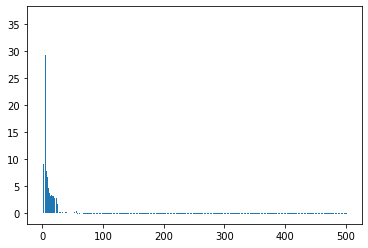

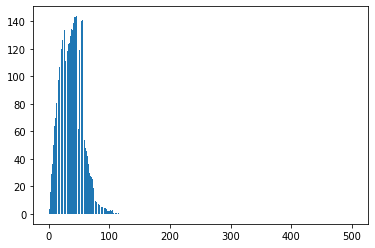

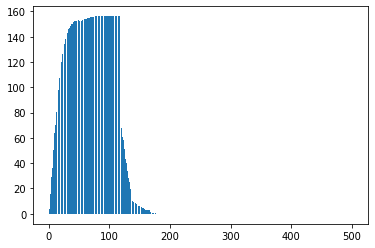

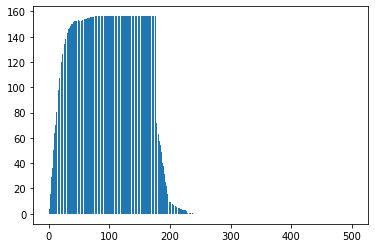

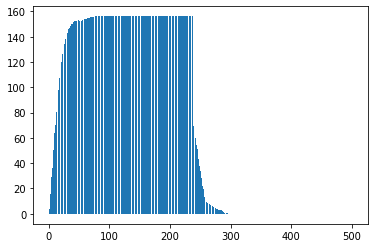

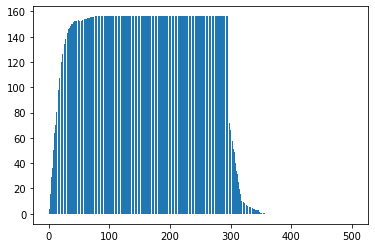

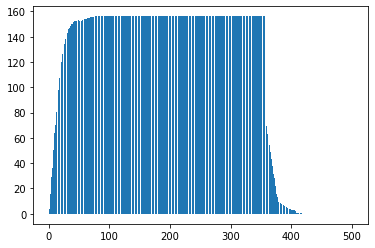

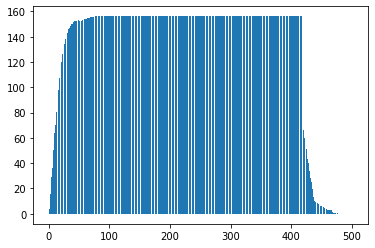

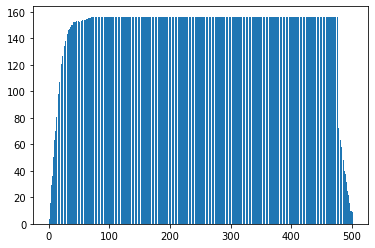

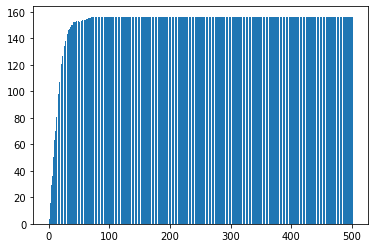

In [54]:
for i in range(10):
    plt.bar(np.arange(502),strategy_list[i])
    plt.savefig(f'{i}.png')
    plt.show()

## Show Convergence

![](res.gif)

## 射各自對應的分數 1倍_外區

In [105]:
strategy[:20]

array([ 0.,  2.,  6., 10., 14., 18., 22., 26., 30., 34., 38., 42., 46.,
       50., 54., 58., 62., 66., 70., 74.])

## 39 ~ 20 瞄準  20 1倍_外區 

In [106]:
strategy[20:40]

array([78., 78., 78., 78., 78., 78., 78., 78., 78., 78., 78., 78., 78.,
       78., 78., 78., 78., 78., 78., 78.])

## 40 ~ 49 分 瞄準 20 * 2 倍區

In [107]:
strategy[40:50]

array([79., 79., 79., 79., 79., 79., 79., 79., 79., 79.])

# 高於 50 分通通瞄準紅心

In [108]:
strategy[50:]

array([80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80.,
       80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80.,
       80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80.,
       80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80.,
       80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80.,
       80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80.,
       80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80.,
       80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80.,
       80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80.,
       80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80.,
       80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80.,
       80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80.,
       80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80.,
       80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80., 80

In [109]:
def play_game_with_strategy(strategy):
    score = 501
    turns = 0
    zone_type=['1x_in','3x','1x_out','2x']
    game = True
    while game:
        turns += 1
        print('================Round {}================'.format(turns))
        print('[Current Points: {} points]'.format(score))
        
        for i in range(3):
           
            act = int(strategy[score-1])
            
            if act == 80:
                act = ['bull']
            else:
                act = [int(act//4)+1,act%4]
                
            if len(act)==1:
                print('--Action: {}'.format(act))
            else:
                print('--Action: {} for {} zone'.format(act[0],zone_type[act[1]]))
                
            minus_point = shoot(act)
            
            if isBust(score,minus_point):
                break
                      
            if isGameOver(score,minus_point):
                print('===========You Win the Game by {} Rounds==========='.format(turns))
                game = False
                break
            
            score -= minus_point
       
    return turns

## Play with Strategy Level - 1

In [110]:
games = 1000
_round = [play_game_with_strategy(strategy) for i in range(games)]

================Round 1================
[Current Points: 501 points]
--Action: ['bull']
hit neighbor: [11] 1x zone!
--Action: ['bull']
hit neighbor: [19] 1x zone!
--Action: ['bull']
hit neighbor: [15] 1x zone!
================Round 2================
[Current Points: 456 points]
--Action: ['bull']
hit neighbor: [19] 1x zone!
--Action: ['bull']
hit neighbor: [13] 1x zone!
--Action: ['bull']
hit neighbor: [19] 1x zone!
================Round 3================
[Current Points: 405 points]
--Action: ['bull']
hit neighbor: [3] 1x zone!
--Action: ['bull']
hit Bull!
--Action: ['bull']
hit Bull!
================Round 4================
[Current Points: 302 points]
--Action: ['bull']
hit neighbor: [5] 1x zone!
--Action: ['bull']
hit neighbor: [14] 1x zone!
--Action: ['bull']
hit Bull!
================Round 5================
[Current Points: 233 points]
--Action: ['bull']
hit neighbor: [6] 1x zone!
--Action: ['bull']
hit neighbor: [3] 1x zone!
--Action: ['bull']
hit neighbor: [10] 1x zone!
========

In [111]:
print(f'Average rounds {np.mean(_round)} for {games} try')
print(f'Average shoot {np.mean(_round)*3} for {games} try')

Average rounds 9.151 for 1000 try
Average shoot 27.453 for 1000 try


## Play Random level 1

In [145]:
games = 1000
_round = [play_game()[0] for i in range(games)]

================Round 1================
[Current Points: 501 points]
--Action: 16 for 2x zone
hit [7] X 2 zone
--Action: 11 for 3x zone
hit [8] X 3 zone
--Action: 3 for 1x_in zone
hit [19] X 1_In zone
================Round 2================
[Current Points: 467 points]
--Action: 16 for 1x_out zone
hit [16] 1x_out zone
--Action: 9 for 2x zone
hit [12] X 2 zone
--Action: 11 for 3x zone
Miss!
================Round 3================
[Current Points: 439 points]
--Action: 4 for 1x_in zone
hit [12] X 1_In zone
--Action: 10 for 1x_out zone
hit [10] 1x_out zone
--Action: 17 for 1x_out zone
hit [17] 1x_out zone
================Round 4================
[Current Points: 400 points]
--Action: 20 for 1x_out zone
hit [20] 1x_out zone
--Action: 13 for 3x zone
hit [13] 3x zone
--Action: 11 for 1x_out zone
hit [11] 1x_out zone
================Round 5================
[Current Points: 330 points]
--Action: 16 for 1x_out zone
hit [16] 1x_out zone
--Action: 19 for 1x_out zone
hit [19] 1x_out zone
--Action: 

In [146]:
print(f'Average rounds {np.mean(_round)} for {games} try')
print(f'Average shoot {np.mean(_round)*3} for {games} try')

Average rounds 14.463 for 1000 try
Average shoot 43.388999999999996 for 1000 try


## Play with Strategy Level - 2

In [139]:
x2_action_cdf, x1_out_action_cdf,x3_action_cdf,x1_in_action_cdf,bull_action_cdf,zone_action_cdf = setPlayer_ability(1)

In [140]:
games = 1000
_round = [play_game_with_strategy(strategy) for i in range(games)]

================Round 1================
[Current Points: 501 points]
--Action: ['bull']
hit neighbor: [18] 1x zone!
--Action: ['bull']
hit neighbor: [1] 1x zone!
--Action: ['bull']
hit Bull!
================Round 2================
[Current Points: 432 points]
--Action: ['bull']
hit Bull!
--Action: ['bull']
hit neighbor: [10] 1x zone!
--Action: ['bull']
hit Bull!
================Round 3================
[Current Points: 322 points]
--Action: ['bull']
hit Bull!
--Action: ['bull']
hit Bull!
--Action: ['bull']
hit neighbor: [17] 1x zone!
================Round 4================
[Current Points: 205 points]
--Action: ['bull']
hit neighbor: [5] 1x zone!
--Action: ['bull']
hit neighbor: [6] 1x zone!
--Action: ['bull']
hit Bull!
================Round 5================
[Current Points: 144 points]
--Action: ['bull']
hit neighbor: [10] 1x zone!
--Action: ['bull']
hit neighbor: [3] 1x zone!
--Action: ['bull']
hit neighbor: [20] 1x zone!
================Round 6================
[Current Points: 111 p

In [141]:
print(f'Average rounds {np.mean(_round)} for {games} try')
print(f'Average shoot {np.mean(_round)*3} for {games} try')

Average rounds 8.831 for 1000 try
Average shoot 26.493 for 1000 try


## Play with Strategy Level - 3

In [142]:
x2_action_cdf, x1_out_action_cdf,x3_action_cdf,x1_in_action_cdf,bull_action_cdf,zone_action_cdf = setPlayer_ability(2)

In [143]:
games = 1000
_round = [play_game_with_strategy(strategy) for i in range(games)]

================Round 1================
[Current Points: 501 points]
--Action: ['bull']
hit neighbor: [20] 1x zone!
--Action: ['bull']
hit Bull!
--Action: ['bull']
hit neighbor: [1] 1x zone!
================Round 2================
[Current Points: 430 points]
--Action: ['bull']
hit neighbor: [6] 1x zone!
--Action: ['bull']
hit neighbor: [20] 1x zone!
--Action: ['bull']
hit Bull!
================Round 3================
[Current Points: 354 points]
--Action: ['bull']
hit neighbor: [20] 1x zone!
--Action: ['bull']
hit neighbor: [14] 1x zone!
--Action: ['bull']
hit Bull!
================Round 4================
[Current Points: 270 points]
--Action: ['bull']
hit neighbor: [2] 1x zone!
--Action: ['bull']
hit neighbor: [7] 1x zone!
--Action: ['bull']
hit neighbor: [11] 1x zone!
================Round 5================
[Current Points: 250 points]
--Action: ['bull']
hit neighbor: [10] 1x zone!
--Action: ['bull']
hit neighbor: [4] 1x zone!
--Action: ['bull']
hit Bull!
================Round 6====

In [144]:
print(f'Average rounds {np.mean(_round)} for {games} try')
print(f'Average shoot {np.mean(_round)*3} for {games} try')

Average rounds 8.617 for 1000 try
Average shoot 25.851000000000003 for 1000 try


## Police with Gamma = 0.01， 證明改變 Gamma 可以改變策略

In [112]:
x2_action_cdf, x1_out_action_cdf,x3_action_cdf,x1_in_action_cdf,bull_action_cdf,zone_action_cdf = setPlayer_ability(0)
strategy_g,strategy_list= mdp(gamma = 0.01,iter_time = 50)

Iter 0
Error ======== 142.18039607237694
Iter 1
Error ======== 208.26931708270786
Iter 2
Error ======== 311.0007633296607
Iter 3
Error ======== 349.79304272524564
Iter 4
Error ======== 448.06604678399196
Iter 5
Error ======== 1016.7684895901386
Iter 6
Error ======== 1631.0202696279073
Iter 7
Error ======== 1793.4359644063998
Iter 8
Error ======== 1791.0776437725708
Iter 9
Error ======== 1685.2750893813313
Iter 10
Error ======== 1631.0828529433493
Iter 11
Error ======== 1642.2511071266777
Iter 12
Error ======== 1653.419791639984
Iter 13
Error ======== 1664.5884761532905
Iter 14
Error ======== 1675.757160666597
Iter 15
Error ======== 1686.925845179903
Iter 16
Error ======== 1698.0945296932093
Iter 17
Error ======== 1709.2632142065147
Iter 18
Error ======== 1720.4318987198212
Iter 19
Error ======== 1731.6005832331275
Iter 20
Error ======== 1742.7692677464343
Iter 21
Error ======== 1753.9379522597405
Iter 22
Error ======== 1765.1066367730468
Iter 23
Error ======== 1776.2753212863531
Iter 2

## 21 瞄 15 分 1_out
##  22 瞄 17 分 1_out

In [114]:
strategy_g[20:40]

array([78., 58., 66., 70., 70., 78., 78., 78., 78., 78., 78., 78., 78.,
       78., 78., 78., 78., 78., 78., 78.])

In [117]:
games = 1000
_round = [play_game_with_strategy(strategy_g) for i in range(games)]

================Round 1================
[Current Points: 501 points]
--Action: ['bull']
hit neighbor: [6] 1x zone!
--Action: ['bull']
hit neighbor: [4] 1x zone!
--Action: ['bull']
hit Bull!
================Round 2================
[Current Points: 441 points]
--Action: ['bull']
hit neighbor: [13] 1x zone!
--Action: ['bull']
hit Bull!
--Action: ['bull']
hit neighbor: [6] 1x zone!
================Round 3================
[Current Points: 372 points]
--Action: ['bull']
hit Bull!
--Action: ['bull']
hit neighbor: [17] 1x zone!
--Action: ['bull']
hit neighbor: [10] 1x zone!
================Round 4================
[Current Points: 295 points]
--Action: ['bull']
hit neighbor: [5] 1x zone!
--Action: ['bull']
hit neighbor: [15] 1x zone!
--Action: ['bull']
hit neighbor: [8] 1x zone!
================Round 5================
[Current Points: 267 points]
--Action: ['bull']
hit Bull!
--Action: ['bull']
hit neighbor: [8] 1x zone!
--Action: ['bull']
hit neighbor: [16] 1x zone!
================Round 6=====

In [118]:
print(f'Average rounds {np.mean(_round)} for {games} try')
print(f'Average shoot {np.mean(_round)*3} for {games} try')

Average rounds 9.219 for 1000 try
Average shoot 27.656999999999996 for 1000 try


In [133]:
x2_action_cdf, x1_out_action_cdf,x3_action_cdf,x1_in_action_cdf,bull_action_cdf,zone_action_cdf = setPlayer_ability(1)

In [134]:
games = 1000
_round = [play_game_with_strategy(strategy_g) for i in range(games)]

================Round 1================
[Current Points: 501 points]
--Action: ['bull']
hit Bull!
--Action: ['bull']
hit neighbor: [6] 1x zone!
--Action: ['bull']
hit neighbor: [15] 1x zone!
================Round 2================
[Current Points: 430 points]
--Action: ['bull']
hit neighbor: [18] 1x zone!
--Action: ['bull']
hit neighbor: [10] 1x zone!
--Action: ['bull']
hit neighbor: [1] 1x zone!
================Round 3================
[Current Points: 401 points]
--Action: ['bull']
hit neighbor: [7] 1x zone!
--Action: ['bull']
hit neighbor: [20] 1x zone!
--Action: ['bull']
hit Bull!
================Round 4================
[Current Points: 324 points]
--Action: ['bull']
hit Bull!
--Action: ['bull']
hit Bull!
--Action: ['bull']
hit neighbor: [9] 1x zone!
================Round 5================
[Current Points: 215 points]
--Action: ['bull']
hit neighbor: [14] 1x zone!
--Action: ['bull']
hit Bull!
--Action: ['bull']
hit neighbor: [14] 1x zone!
================Round 6================
[Cur

In [135]:
print(f'Average rounds {np.mean(_round)} for {games} try')
print(f'Average shoot {np.mean(_round)*3} for {games} try')

Average rounds 8.88 for 1000 try
Average shoot 26.64 for 1000 try


In [136]:
x2_action_cdf, x1_out_action_cdf,x3_action_cdf,x1_in_action_cdf,bull_action_cdf,zone_action_cdf = setPlayer_ability(2)

In [137]:
games = 1000
_round = [play_game_with_strategy(strategy) for i in range(games)]

================Round 1================
[Current Points: 501 points]
--Action: ['bull']
hit neighbor: [5] 1x zone!
--Action: ['bull']
hit neighbor: [7] 1x zone!
--Action: ['bull']
hit neighbor: [9] 1x zone!
================Round 2================
[Current Points: 480 points]
--Action: ['bull']
hit Bull!
--Action: ['bull']
hit neighbor: [16] 1x zone!
--Action: ['bull']
hit Bull!
================Round 3================
[Current Points: 364 points]
--Action: ['bull']
hit neighbor: [9] 1x zone!
--Action: ['bull']
hit neighbor: [15] 1x zone!
--Action: ['bull']
hit neighbor: [14] 1x zone!
================Round 4================
[Current Points: 326 points]
--Action: ['bull']
hit neighbor: [13] 1x zone!
--Action: ['bull']
hit Bull!
--Action: ['bull']
hit neighbor: [14] 1x zone!
================Round 5================
[Current Points: 249 points]
--Action: ['bull']
hit Bull!
--Action: ['bull']
hit neighbor: [19] 1x zone!
--Action: ['bull']
hit neighbor: [13] 1x zone!
================Round 6===

In [138]:
print(f'Average rounds {np.mean(_round)} for {games} try')
print(f'Average shoot {np.mean(_round)*3} for {games} try')

Average rounds 8.484 for 1000 try
Average shoot 25.451999999999998 for 1000 try


## 個別強度與策略的平均 Round 數

|  Police   | Level 1 | Level 2 | Level 3 |
| -------- | -------- | -------- | -------- |
|Gamma 0.99|  9.15    |  8.83    |  8.62  |
|Gamma 0.01|  9.22    | 8.88     |  8.48  |
|Random    |  14.41   |  14.52   | 14.06  |